# Array measurements ROBAT 226.238:
- 5 mic array adafruit 5 i2s (from 1=left to 5=right)
- 48khz 
- 1.5 meters distance (~ far field = 10𝛌; 𝛌max = fmin; 343/2 = 171 Hz --> 10𝛌 = 1715 Hz; at 1000Hz: 4.5𝛌 = 4.5*0.343 = 1.5435 m)
- measured clockwise (R: 0-180; L: 180-360)
- array rotated around the central mic kept a 1.5m from source

**HW settings:**
- Harman kandon AWR 445 vol = -25 db (front: 270 to 90)
- Harman kandon AWR 445 vol = -5 db (back: 100 to 260)
- fireface analog out 1/2 stereo vol = 0db
- tweeter #1
- Ref mic: gras +30 db fireface channel 9, +20db channel A power module

**NOTE:**


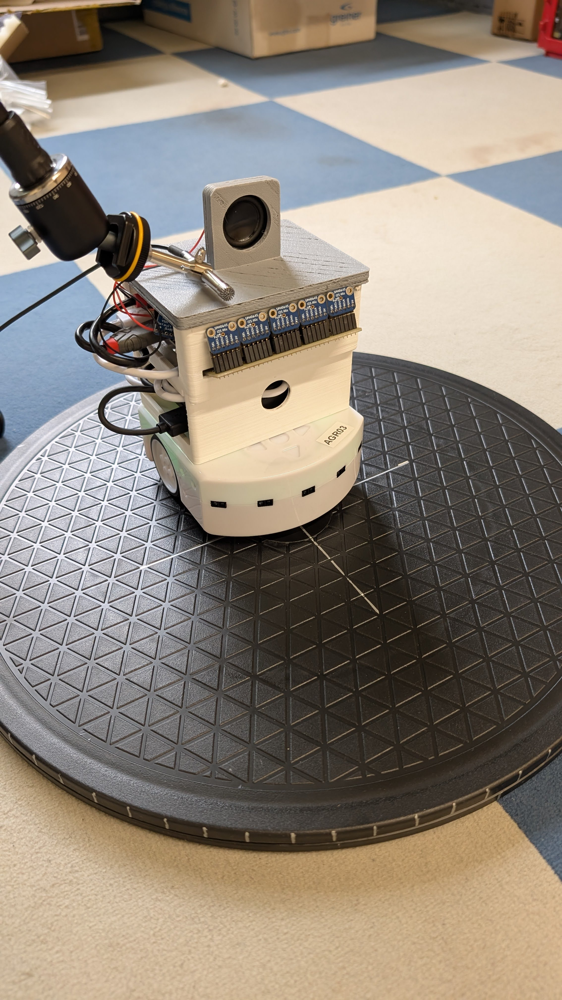

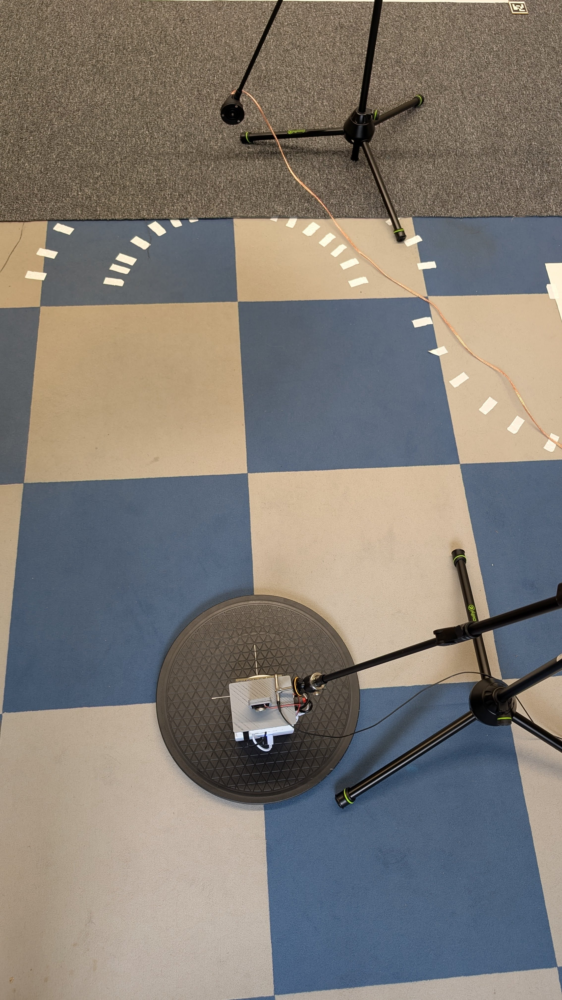

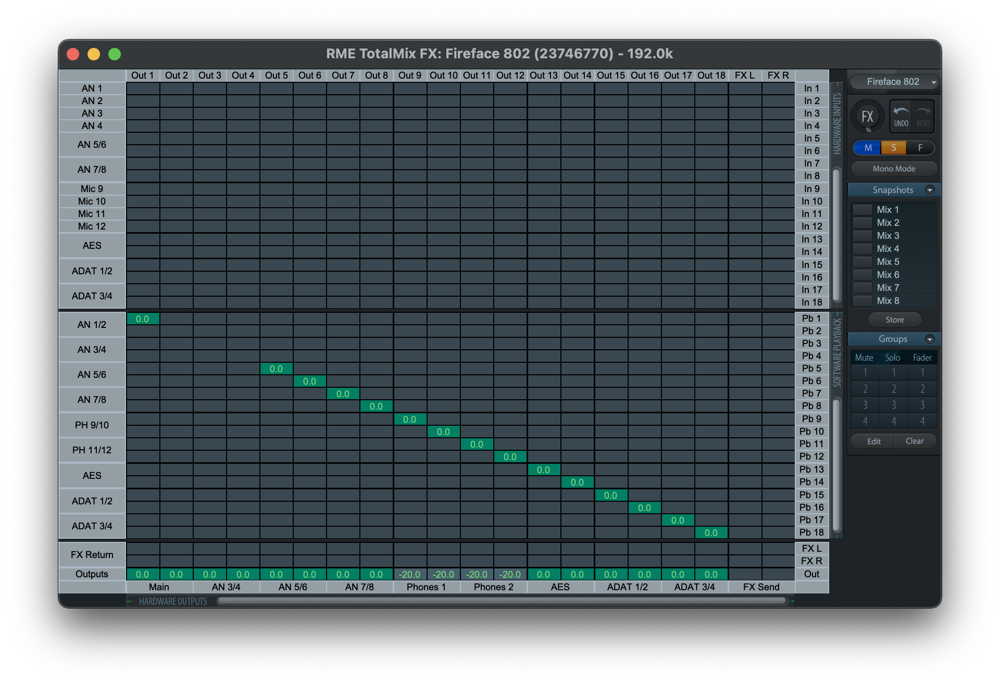

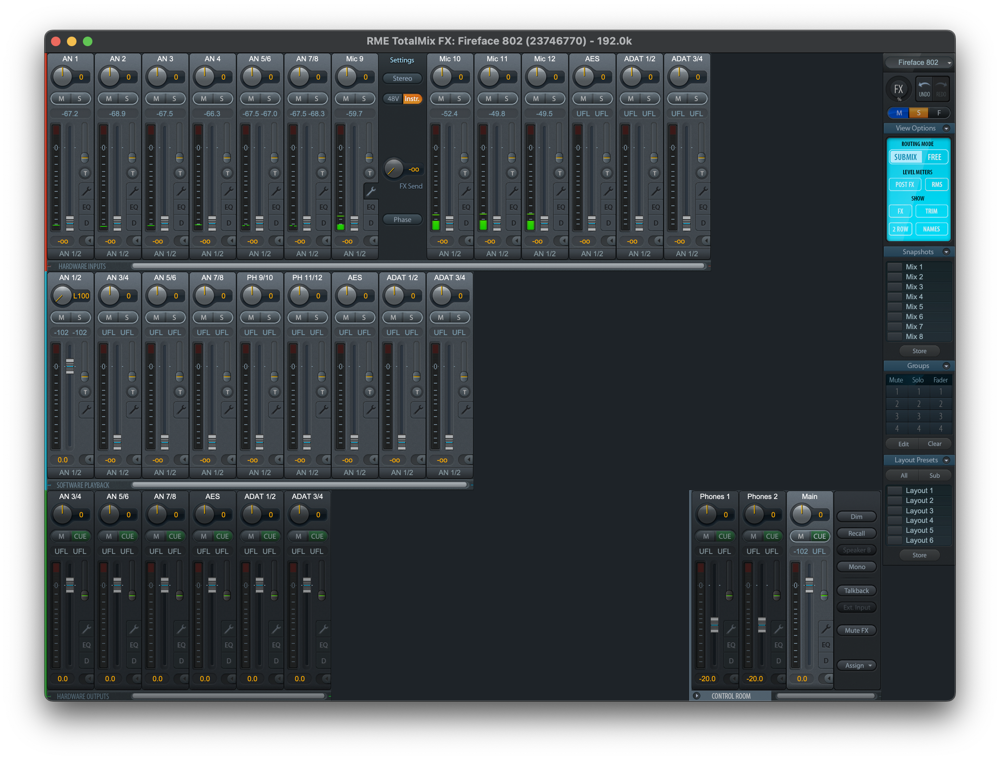

In [1]:
from IPython.display import Image
from IPython.display import display

display(
    Image(filename="./PXL_20250509_10061094.jpg", width=300),
    Image(filename="./PXL_20250509_10062195.jpg", width=300),
    Image(filename="./rme802_matrix.png", width=700),
    Image(filename="./rme802_mixer.png", width=700)
)

# Output signal

Out signal used during the recordings: 1-40Khz 5ms sweep.
Having a signal with different set of sweeps of different length, allows to have repeatibility of the same signal type (useful to avarage and reduce errors), but also having the sweep energy distributed over different time frames. 
Most of the analysis here take advantage of this signal structure (for example by avaraging over different sweeps) to obtain the results. 

/Users/alberto/anaconda3/envs/Tesipython/lib/python3.12/site-packages/matplotlib/axes/_axes.py:7947: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


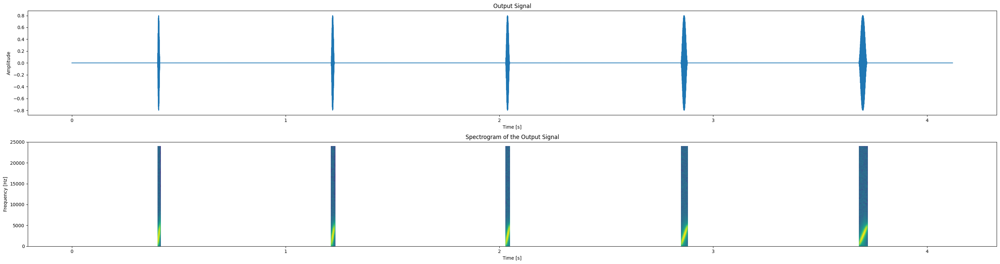

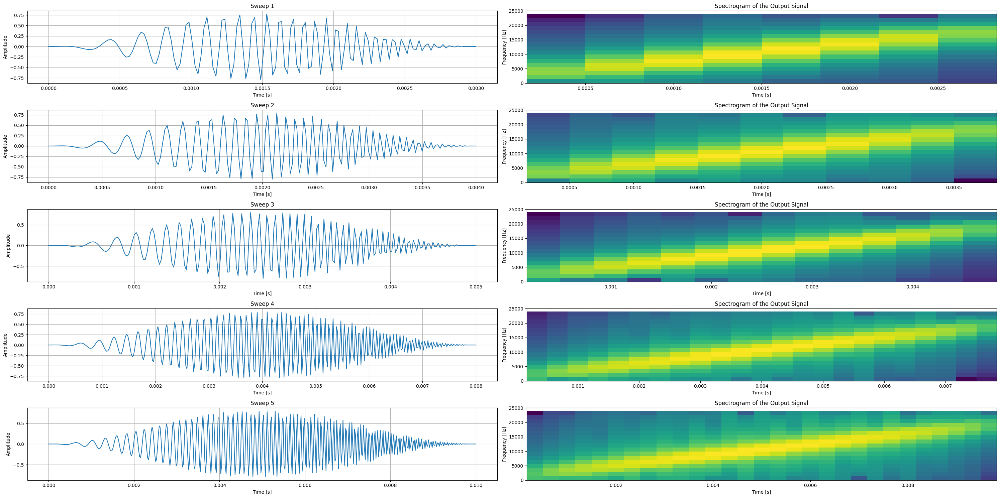

In [2]:
import scipy.signal as signal 
import numpy as np 
import matplotlib.pyplot as plt 
import sounddevice as sd
import soundfile as sf

# Set this variable to True to print, False to skip printing
do_print = False

#%%
# make a sweep
durns = np.array([3, 4, 5, 8, 10] )*1e-3
fs = 48000 # Hz

chirp = []
all_sweeps = []
for durn in durns:
    t = np.linspace(0, durn, int(fs*durn))
    start_f, end_f = 1e3, 20e3
    sweep = signal.chirp(t, start_f, t[-1], end_f)
    sweep *= signal.windows.tukey(sweep.size, 0.95)
    sweep *= 0.8
    sweep_padded = np.pad(sweep, pad_width=[int(fs*0.1)]*2, constant_values=[0,0])
    all_sweeps.append(sweep_padded)
    chirp.append(sweep)
    

sweeps_combined = np.concatenate(all_sweeps)

# Read the saved WAV file
out_signal, _ = sf.read('1_20k_5sweeps.wav')

# Plot the time-domain signal and spectrogram
plt.figure(figsize=(30, 8))

# Time-domain plot
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(out_signal) / fs, len(out_signal)), out_signal)
plt.title('Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Spectrogram plot
plt.subplot(2, 1, 2, sharex=plt.gca())
plt.specgram(out_signal, Fs=fs, NFFT=512, noverlap=256, cmap='viridis')
plt.title('Spectrogram of the Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.ylim(0, 25e3)
plt.tight_layout()

# plot the chirp
plt.figure(figsize=(30, 15))
for i, sweep in enumerate(chirp):
    plt.subplot(len(chirp), 2, 2 * i + 1)
    plt.plot(np.linspace(0, len(sweep) / fs, len(sweep)), sweep)
    plt.title(f'Sweep {i+1}')
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    plt.grid()
    # Spectrogram plot

    plt.subplot(len(chirp), 2, 2 * i + 2)
    plt.specgram(sweep, Fs=fs, NFFT=32, noverlap=16, cmap='viridis')
    plt.title('Spectrogram of the Output Signal')
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.ylim(0, 25e3)

plt.tight_layout()
plt.show()


# Audio analysis of the recordings

A preprocessing of the signal is needed, since the array has 5 mics and it is tested over 360 degrees around the robot:
1. The angular audiofiles are imported and extracted from multiwav to single channel recordings.


In [3]:
# %% Libraries and files
import os
import soundfile as sf

# Load audio files, then plot a 6x6 grid
DIR = "./2025-05-09/original/"  # Directory containing the audio files
audio_files = os.listdir(DIR)  # List all files in the sweeps directory
audio_files.sort()  # Sort the files in ascending order

# Directory to save the extracted channels
output_dir = "./2025-05-09/extracted_channels/"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Path to the multi-channel WAV file
for file in audio_files:
    file_path = os.path.join(DIR, file)

    angle_name = file.split('.')[0]
    if do_print:
        print(f"Processing file: {angle_name}")

    # Read the multi-channel WAV file
    audio_data, sample_rate = sf.read(DIR + file)
    
    # Check the shape of the audio data
    if do_print:
        print(f"Audio data shape: {audio_data.shape}")  # (samples, channels)

    # Extract individual channels
    num_channels = audio_data.shape[1]  # Number of channels
    channels = [audio_data[:, i] for i in range(num_channels)]

    # Save each channel as a separate WAV file
    for i, channel_data in enumerate(channels):
        output_file = os.path.join(output_dir + "channel_separation", angle_name+f"_{i + 1}.wav")  # Path to the output file
        os.makedirs(output_dir + "channel_separation", exist_ok=True)  # Create the directory if it doesn't exist
        sf.write(output_file, channel_data, sample_rate)
        if do_print:
            print(f"Saved channel {i + 1} to {output_file}")


2. Sorting of the angular extracted files into the separate channels (in this case microphones of the array)

In [4]:
# List all extracted channel files separated by channel number
from natsort import natsorted

# Directory containing the extracted channels
extracted_channels_dir = "./2025-05-09/extracted_channels/channel_separation/"

# List all extracted channel files
channel_files = os.listdir(extracted_channels_dir)

# Filter out directories and non-audio files, keep only valid files
channel_files = [f for f in channel_files if os.path.isfile(os.path.join(extracted_channels_dir, f)) and f.endswith('.wav')]

# Sort the files naturally by the last part of their names (e.g., channel number)
sorted_channel_files = natsorted(channel_files, key=lambda x: int(x.split('_')[-1].split('.')[0]))

# Group files by the last part of their name (channel number)
grouped_files = {}

for file in sorted_channel_files:
    # Extract the channel number from the file name (e.g., "350_1.wav" -> "1")
    channel_number = int(file.split('_')[-1].split('.')[0])

    # Group files by channel number
    if channel_number not in grouped_files:
        grouped_files[channel_number] = []
    grouped_files[channel_number].append(file)

for i in range(len(grouped_files)):
    grouped_files[i+1].sort()

# Print grouped files
if do_print:
    for channel_number, files in grouped_files.items():
        print(f"Channel {channel_number}:")
        for f in files:
            print(f"  {f}")


3. HighPass filtering, matched filtering, peak extraction, RMS calculation:
 - Every file is uploaded and HP filtered to eliminate the DC bias of the mics. 
 - Every file is matched with the output chirp template.
 - The sweep position is extracted from each file. 
 - The extracted sweep is isolated and saved in a new directory to be analysed.
 - The avarage RMS of all the sweeps in every recording is calculated and saved in a dictionary.

/var/folders/pc/w8yjxfyn7g93139kxqngkny00000gn/T/ipykernel_36293/405694642.py:18: RuntimeWarning: divide by zero encountered in log10
  plt.plot(w, 20 * np.log10(abs(h)))


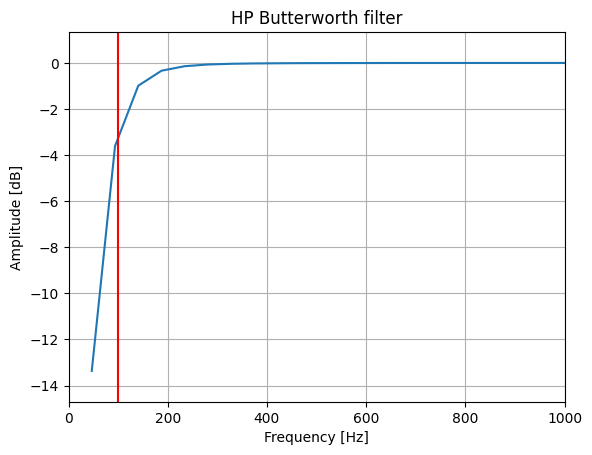

In [5]:
from scipy.signal import sosfreqz
import scipy.signal as sig

gain = 20 # dB

db_to_linear = lambda X: 10**(X/20)
dB = lambda X: 20 * np.log10(abs(np.array(X).flatten()))

extracted_channels_dir = "./2025-05-09/extracted_channels/channel_separation/"
saving_dir = "./2025-05-09/extracted_channels/"

# Design the highpass filter
cutoff = 100 # cutoff frequency in Hz
sos = signal.butter(2, cutoff, 'hp', fs=fs, output='sos')
w, h = sosfreqz(sos, fs=fs)

# Plot the filter frequency response
plt.plot(w, 20 * np.log10(abs(h)))
plt.title('HP Butterworth filter')
plt.xlabel('Frequency [Hz]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(cutoff, color='red') # cutoff frequency
plt.xlim(0, 1000)
plt.show()

# Define the matched filter function
def matched_filter(recording, chirp_template):
    filtered_output = np.roll(signal.correlate(recording, chirp_template, 'same', method='direct'), -len(chirp_template)//2)
    filtered_output *= signal.windows.tukey(filtered_output.size, 0.1)
    filtered_envelope = np.abs(signal.hilbert(filtered_output))
    return filtered_envelope

# Detect peaks in the matched filter output
def detect_peaks(filtered_output):
    peaks, properties = signal.find_peaks(filtered_output, prominence=0.1, distance=0.2 * sample_rate)
    return peaks

# Dictionary to store RMS values for all files
rms_values_dict = {}

channel_number = 0
for i in range(len(grouped_files)):
    channel_number += 1
    files = grouped_files[i+1]
    if do_print:
        print(f"\nProcessing Channel {channel_number}:\n")
    
        # Create a new figure for each channel
        fig, ax = plt.subplots(figsize=(15, 5))
        ax.set_title(f"Channel {channel_number}", fontsize=20)
        ax.set_xlabel("Seconds")
        ax.set_ylabel("Amplitude")
        ax.grid(True)

    for file in files[0:len(files)]:
        file_path = os.path.join(extracted_channels_dir, file)
        recording, sample_rate = sf.read(file_path)
        recording = sig.sosfilt(sos, recording)

        angle_name = int(file.split('_')[0])

        if 100 <= angle_name <= 260:  
            recording *= db_to_linear(-gain)
        rms_values = []

        # Apply matched filtering for each chirp template
        for idx_chirp, chirp_template in enumerate(chirp):
            filtered_output = matched_filter(recording, chirp_template)

            # Detect peaks
            peaks = detect_peaks(filtered_output)
            if do_print:
                print(f"Peaks detected in {file}: {len(peaks)} with {idx_chirp+1} chirp template")

                ax.plot(np.linspace(0, len(filtered_output) / sample_rate, len(filtered_output)), filtered_output, label=f"Filtered Output - {file}")
                #ax.plot(np.linspace(0, len(filtered_envelope) / sample_rate, len(filtered_envelope)), filtered_envelope, label=f"Filtered env - {file}", color='orange')
                ax.plot(np.linspace(0, len(recording) / sample_rate, len(recording)), recording, label=f"rec - {file}")
                #ax.legend(loc='upper right')
                #ax.set_xlim(5.15, 5.18)
                ax.set_xlim(2, 7)

                # Plot peaks on the filtered output
                ax.plot(peaks / sample_rate, filtered_output[peaks], "x", label="Detected Peaks")
                #ax.legend(loc='upper right')
            
            if len(peaks) > 0:
                # Extract the first sweep
                sweep_start = peaks[idx_chirp]
                sweep_end = sweep_start + len(chirp_template)
                sweep = recording[sweep_start:sweep_end]

                # Calculate RMS value of the first sweep
                rms = np.sqrt(np.mean(sweep**2))


                if do_print:
                    print(f"RMS value of sweep at peak {peaks[idx_chirp]/sample_rate} sec in {file}: {rms:.5f}")
                # Process each channel
                DIR_sweep = saving_dir + f"sweep_{idx_chirp+1}/"  # Directory to save the first sweeps
                os.makedirs(DIR_sweep, exist_ok=True)  # Create the directory if it doesn't exist

                sf.write(DIR_sweep + file, sweep, int(sample_rate))
                
                # Store RMS value in the dictionary
            else:
                if do_print:
                    print(f"No sweeps detected in {file} - Channel {channel_number}")
            # # Calculate RMS values for all detected peaks
                # if do_print:
                #     print(f"Average RMS value of all sweeps in {file}: {average_rms:.5f}")
            
            rms_values.append(rms)
            if do_print:
                print(f"rms_values in {file}: {rms_values}")
            

        rms_values_dict[file] = np.mean(rms_values)

# Print the dictionary of RMS values
if do_print:
    print("\nRMS Values for All Files:")
    for file, rms_value in rms_values_dict.items():
        print(f"{file}: {rms_value:.5f}")

plt.show(block = False)


4. The filtered sweeps in the files can be visualised to check for consistency across angles. 

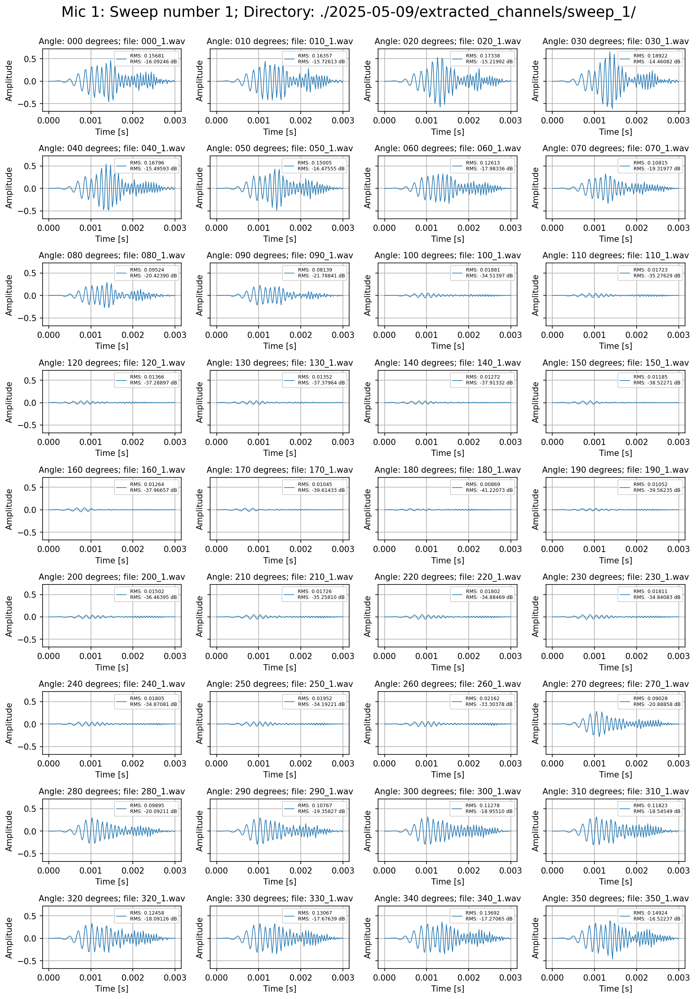

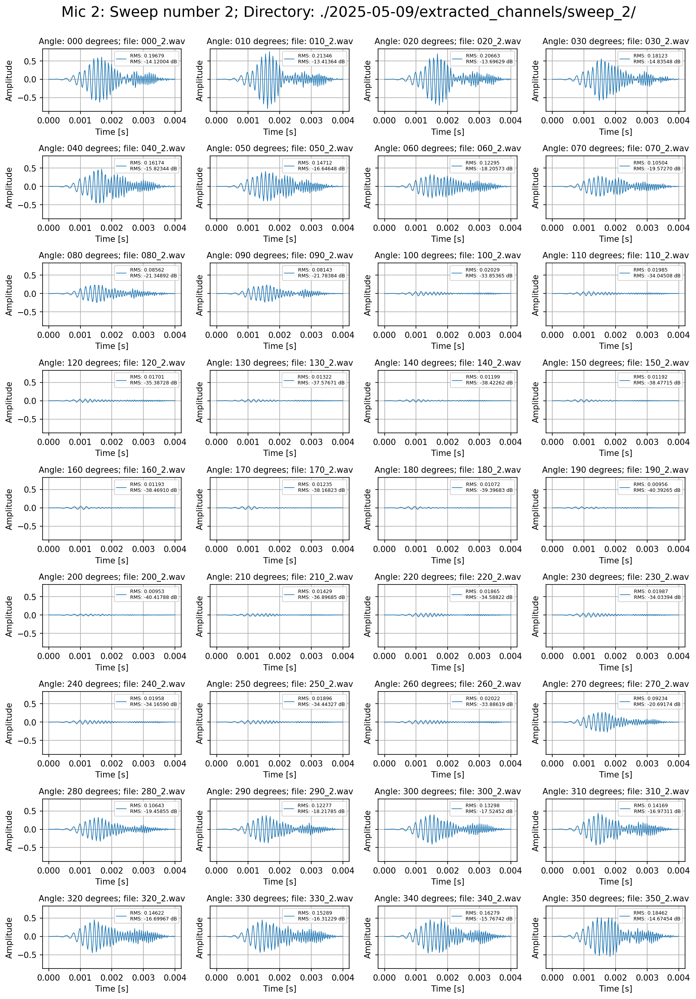

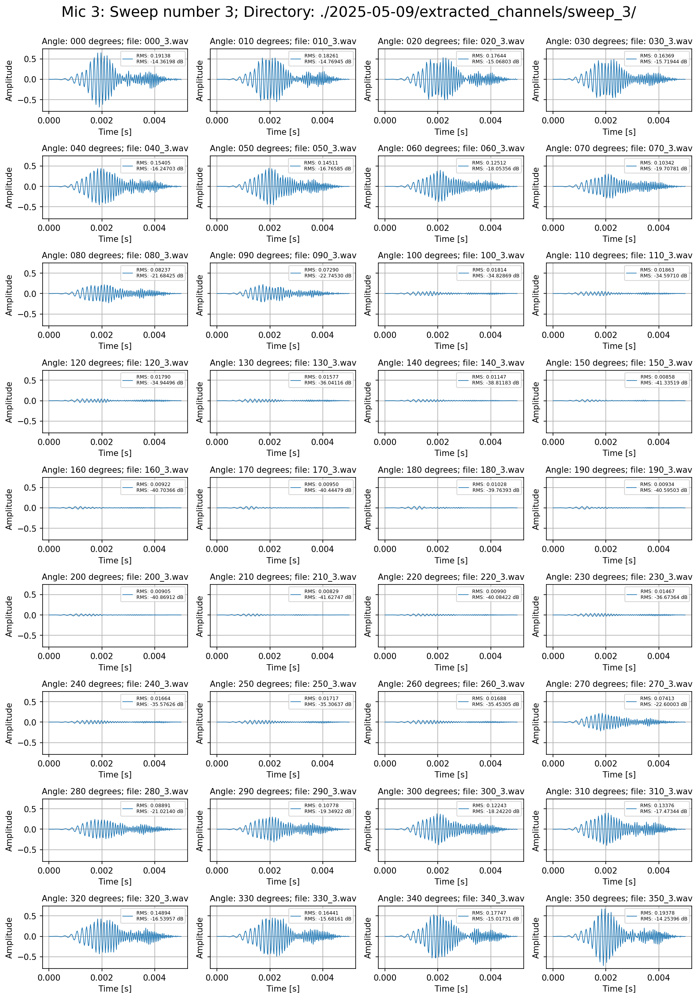

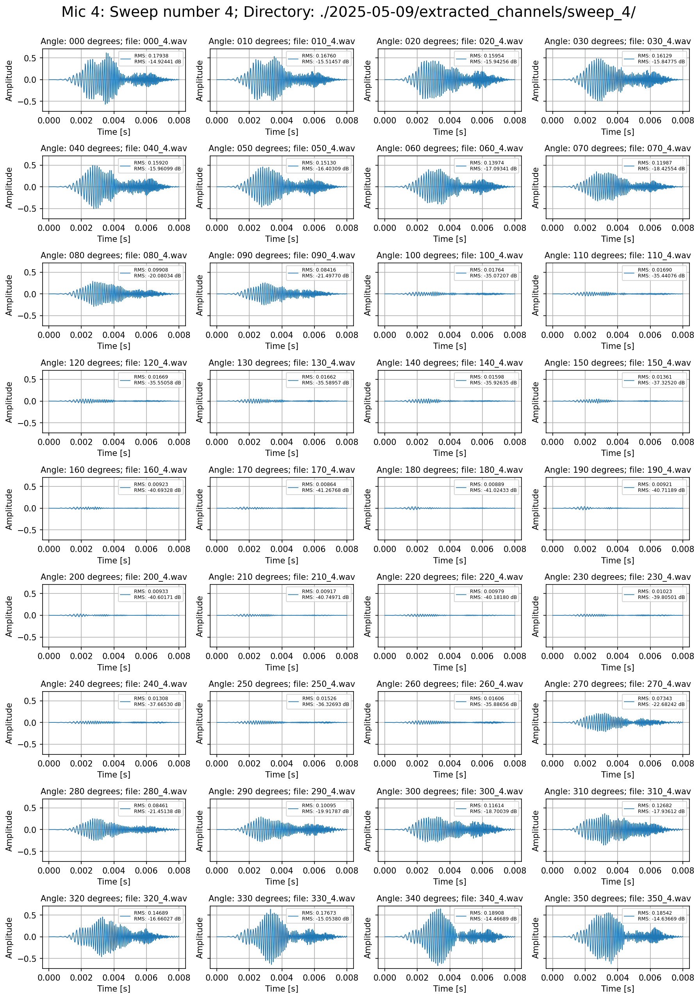

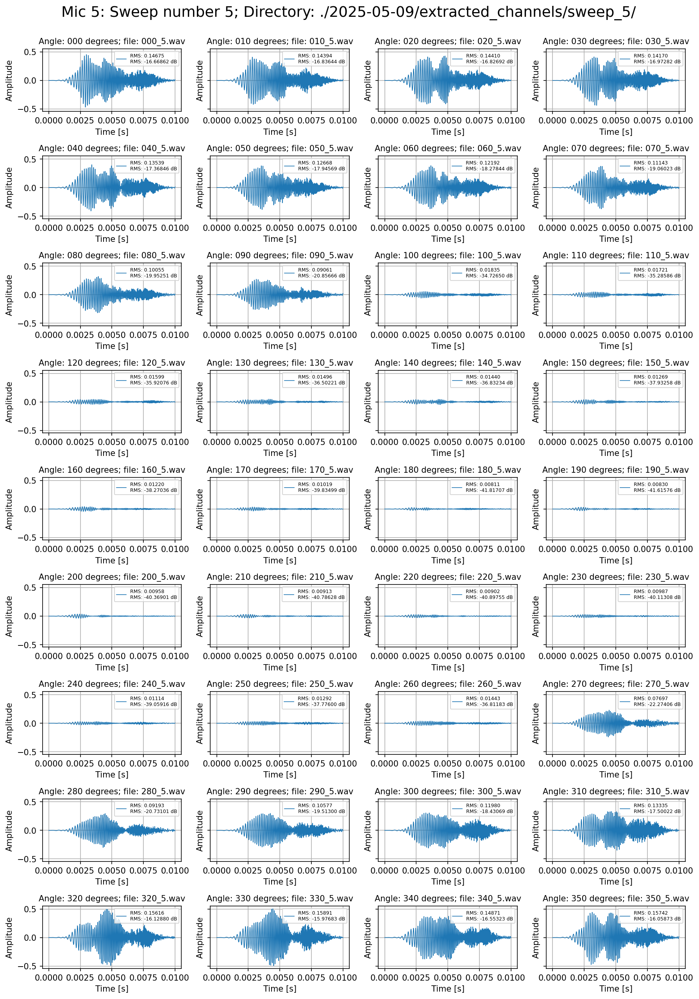

In [6]:
angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

channel_number = 0
sweep_to_plot = 1
for i in range(len(grouped_files)):
    DIR_sweep = saving_dir + f"sweep_{sweep_to_plot}/"  
    channel_number += 1
    files = grouped_files[i+1]
    # Plot all angles, skipping '360'
    fig1, axs = plt.subplots(9, 4, figsize=(12, 17), sharey=True, dpi = 150)
    angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

    idx_to_plot = 0
    for idx, file in enumerate(files):
        if angles[idx] == '360':
            continue  # Skip the 360 angle

        file_path = os.path.join(DIR_sweep, file)
        audio, sample_rate = sf.read(file_path)

        rms = np.sqrt(np.mean(audio**2))
        rms_db = 20 * np.log10(rms)
        
        row = idx_to_plot // 4
        col = idx_to_plot % 4
        
        ax = axs[row, col]
        ax.plot(np.linspace(0, len(audio) / sample_rate, len(audio)), audio, linewidth=0.8)
        ax.set_title(f"Angle: {angles[idx]} degrees; file: {file}", fontsize = 10)  # Use extracted angle name with units
        ax.set_xlabel("Time [s]")
        ax.set_ylabel(f"Amplitude")
        ax.grid(True)
        ax.legend([f'RMS: {rms:.5f}\nRMS: {rms_db:.5f} dB'], loc='upper right', fontsize=6)

        idx_to_plot += 1
    # Add suptitle after plotting all subplots
    plt.suptitle(f"Mic {channel_number}: Sweep number {sweep_to_plot}; Directory: {DIR_sweep}", fontsize=18, y=1)
    plt.tight_layout()  # Adjust layout to make room for suptitle
    plt.show(block = False)
    sweep_to_plot += 1

plt.show(block = False)

if do_print:
    # Print the dictionary of RMS values
    print("\nRMS Values for All Files:")
    for file, rms_value in rms_values_dict.items():
        print(f"{file}: {rms_value:.5f}")


5. RMS values of the overall recording are displayed in a polar plot for each of the 5 microphones in the array to investigate the ability of the array (and the robot) to capture overall sound intensity.

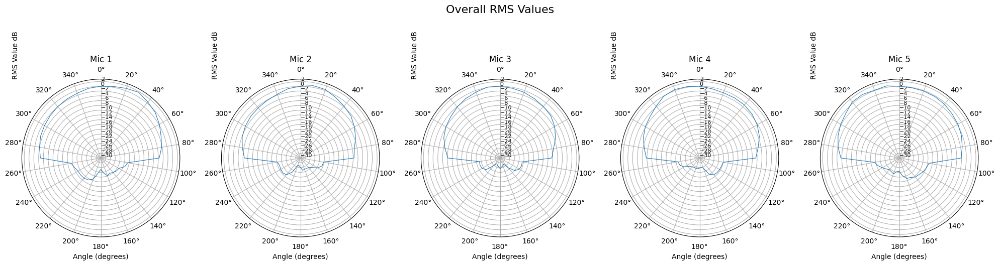

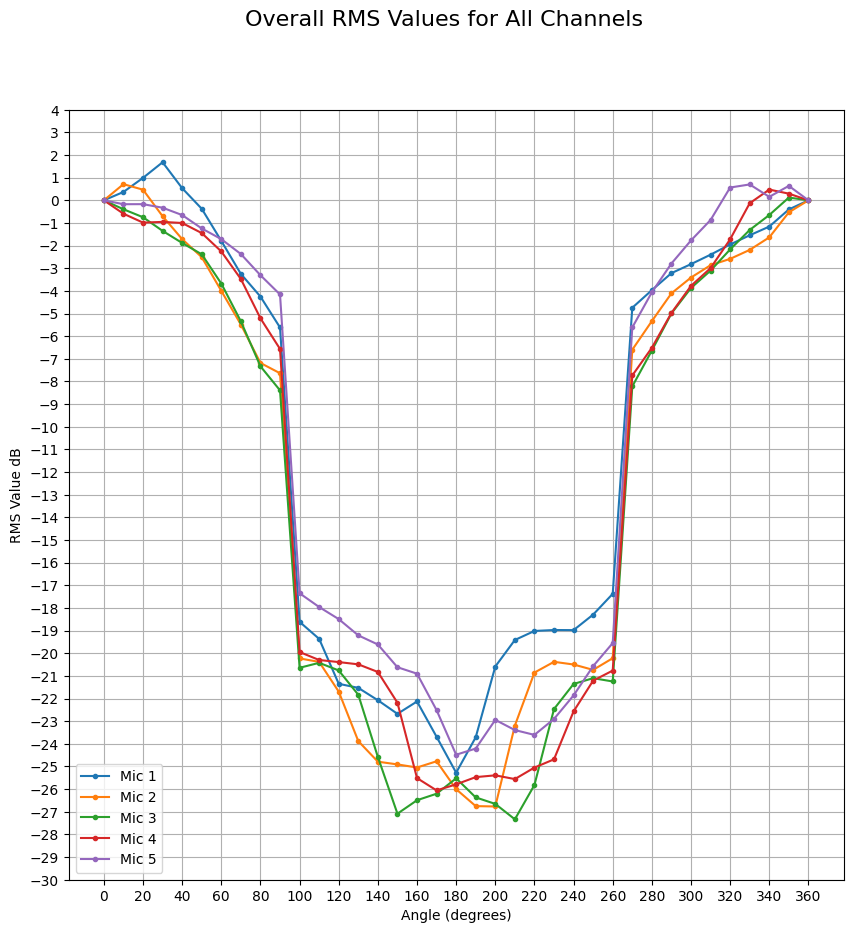

In [7]:
# RMS values of the overall recording for each channel and each angle

num_channels = len(grouped_files)
fig_polar, axs_polar = plt.subplots(1, num_channels, figsize=(20,6), subplot_kw={'projection': 'polar'})
fig_polar.suptitle("Overall RMS Values", fontsize=16)

fig_linear, ax_linear = plt.subplots(figsize=(10, 10))
fig_linear.suptitle("Overall RMS Values for All Channels", fontsize=16)

for i in range(num_channels):
    channel_number = i + 1
    files = grouped_files[channel_number]
    
    rms_values = []
    rms_values_norm_db = []
    angles = []
    
    for file in files:

        rms = rms_values_dict[file]
        
        rms_values.append(rms)

        rms_values_norm = rms_values / rms_values[0]
        rms_values_norm_db = 20 * np.log10(rms_values_norm)

        angle_name = file.split('_')[0]
        angles.append(int(angle_name))
    
    # Convert angles to radians
    angles_rad = np.radians(angles)
    
    # Plot RMS values in polar plot
    ax_polar = axs_polar[i] if num_channels > 1 else axs_polar
    ax_polar.plot(angles_rad, rms_values_norm_db, linewidth=0.8)
    ax_polar.set_title(f"Mic {channel_number}")
    ax_polar.set_theta_zero_location("N")  # Set 0 degrees to North
    ax_polar.set_theta_direction(-1)  # Set clockwise direction
    ax_polar.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
    ax_polar.set_xlabel("Angle (degrees)") 
    ax_polar.tick_params(axis='y', labelsize=8)
    ax_polar.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
    ax_polar.set_rlabel_position(0)
    ax_polar.set_rlim(-30, 3)  # Set radial limits
    ax_polar.set_yticks(np.arange(-30, 3, 2))  # Set y-ticks

    # Plot RMS values in linear plot
    ax_linear.plot(angles, rms_values_norm_db, marker='.', linestyle='-', label=f"Mic {channel_number}")
    ax_linear.set_xlabel("Angle (degrees)")
    ax_linear.set_xticks(np.linspace(0, 380, 19, endpoint=False))  # Set angle ticks
    ax_linear.set_ylabel("RMS Value dB")
    ax_linear.set_yticks(np.arange(-30, 5, 1))  # Set y-ticks
    ax_linear.legend()
    ax_linear.grid(True)

fig_polar.tight_layout()
plt.show(block = False)


6. The overall RMS value displayed in #5 is also analysed across frequencies up to 40 KHz to investigate how/if those are be captured by the microphones.

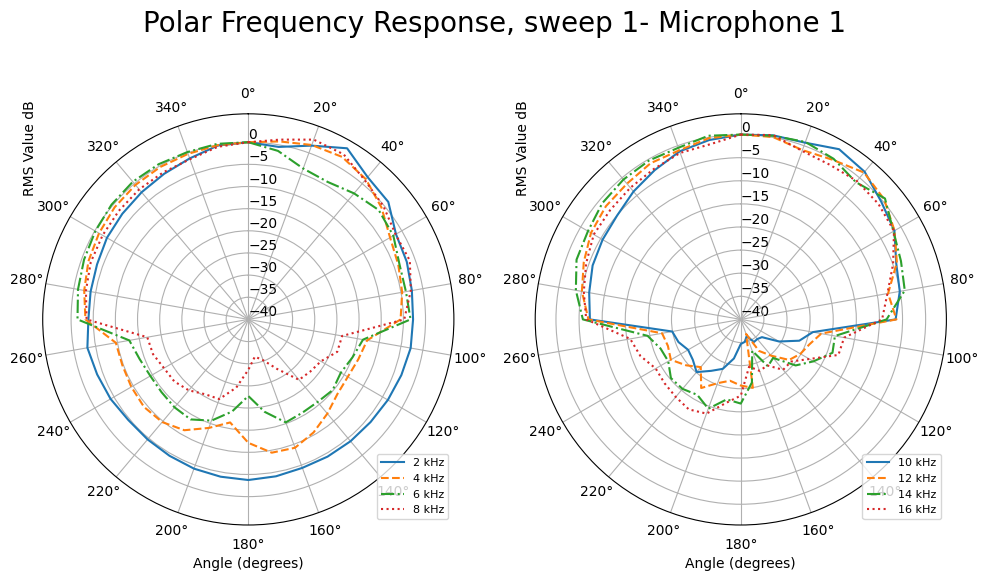

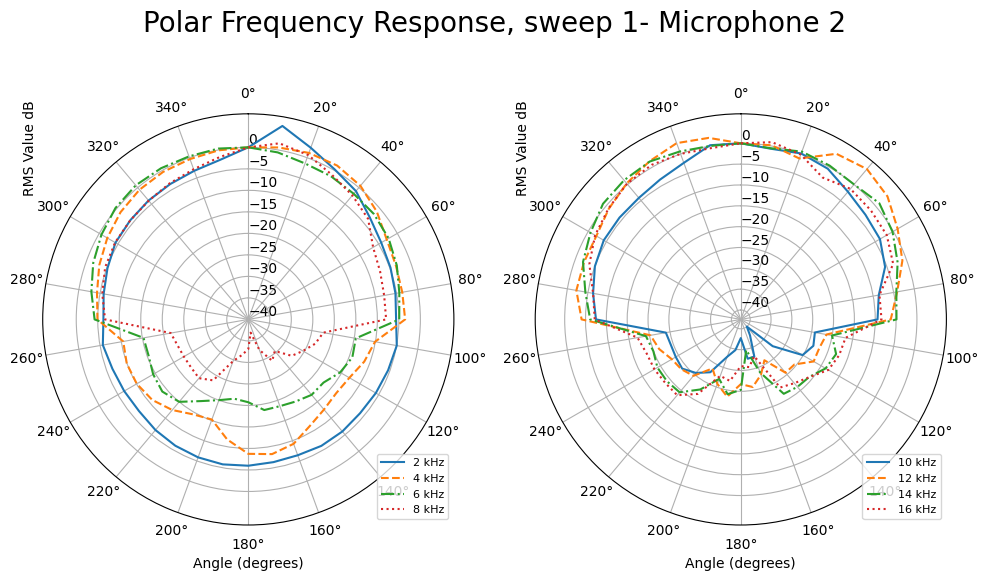

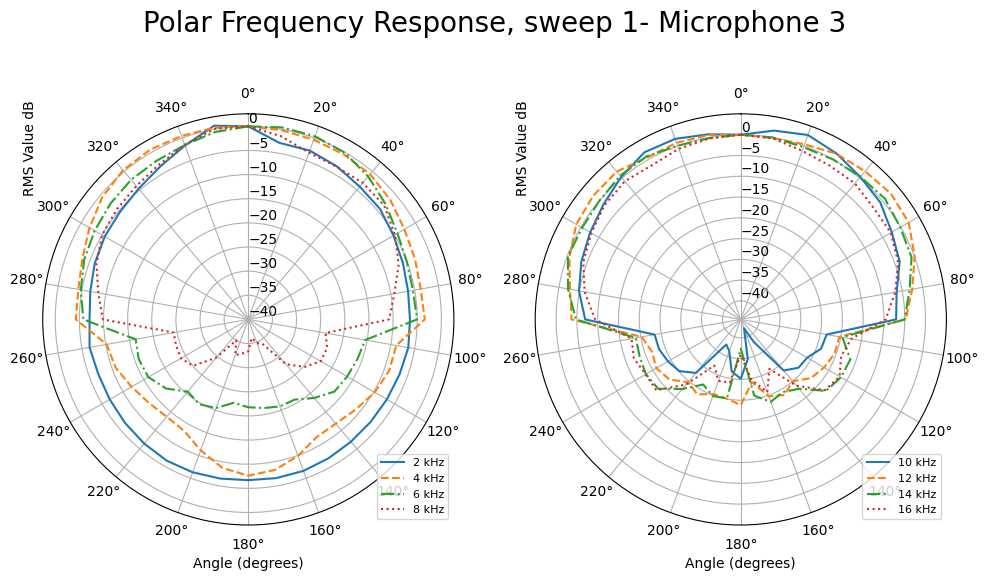

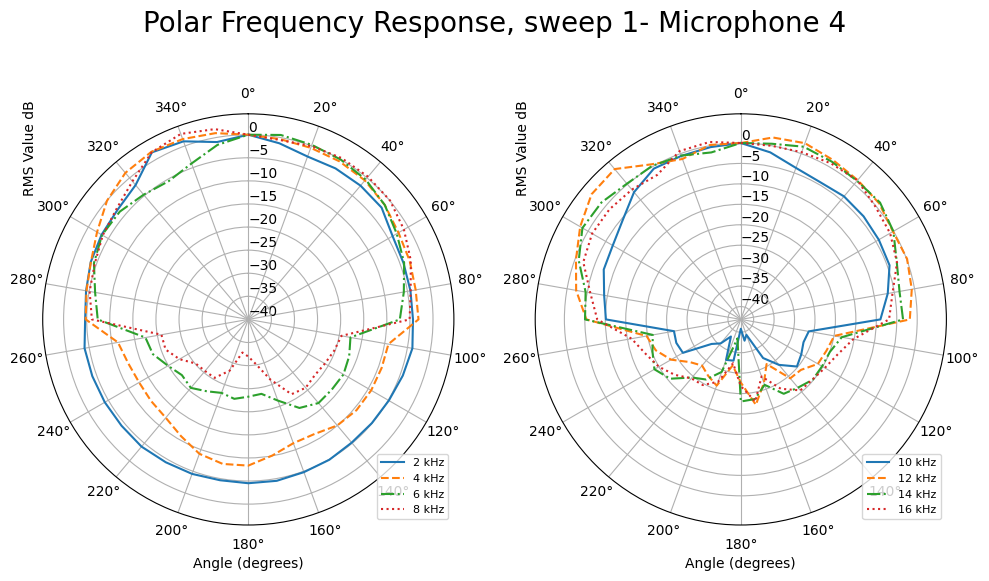

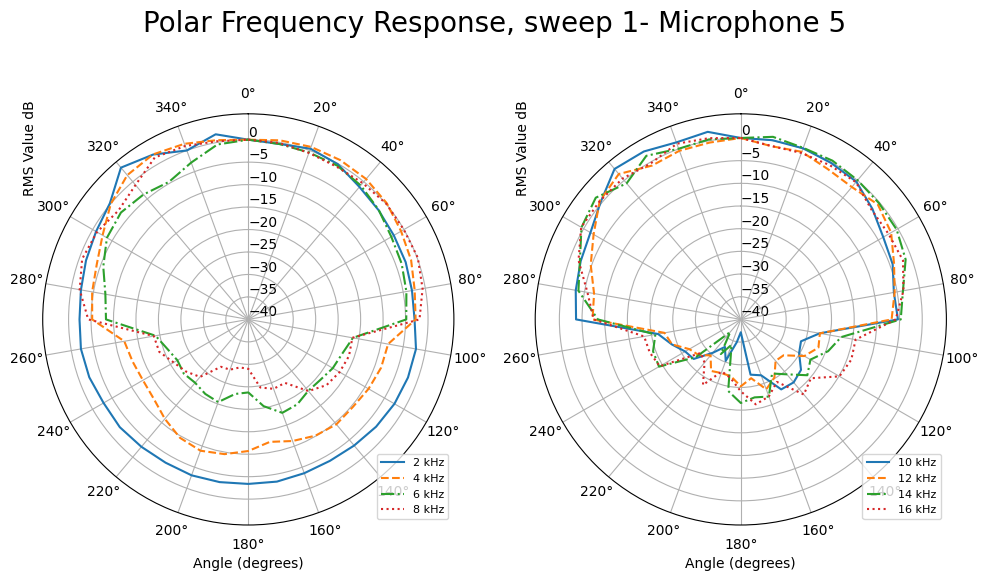

In [8]:
import soundfile as sf
from scipy import fft

sweep_to_plot = 1 

DIR = f"./2025-05-09/extracted_channels/sweep_{sweep_to_plot}/"  # Directory containing the audio files

# Central frequencies of the bands
central_freq = np.array([2e3, 4e3, 6e3, 8e3, 10e3, 12e3, 14e3, 16e3])
BW = 1e3  # Bandwidth of the bands
linestyles = ["-", "--", "-.", ":"]  # Line styles for the plot
# Group central frequencies into 3 sets of 6 bands each
num_bands_per_plot = 4
central_freq_sets = [central_freq[i * num_bands_per_plot:(i + 1) * num_bands_per_plot] for i in range(3)]
# Number of microphones
num_mics = num_channels
# Plot for each microphone
for mic in range(1, num_mics + 1):
    files = grouped_files[mic]
    angles = [int(file.split('_')[0]) for file in files]  # Extract angles from filenames
    # Create a figure with 3 polar subplots
    fig, axes = plt.subplots(1, 2, subplot_kw={"projection": "polar"}, figsize=(10, 6))
    plt.suptitle(f"Polar Frequency Response, sweep {sweep_to_plot}- Microphone {mic}", fontsize=20)
    for ax_idx, ax in enumerate(axes):
        ii = 0
        for fc in central_freq_sets[ax_idx]:
        
            audio_patt = []
            for file in files:
                file_path = os.path.join(DIR, file)
                audio, fs = sf.read(file_path)
                # Compute FFT
                audio_freq = fft.fft(audio, n=2048)
                audio_freq = audio_freq[:1024]
                freqs = fft.fftfreq(2048, 1 / fs)[:1024]
                # Compute mean radiance in the band
                band_mean = np.mean(np.abs(audio_freq[(freqs > fc - BW) & (freqs < fc + BW)]))
                audio_patt.append(band_mean)
            # Normalize and plot
            audio_patt_norm = audio_patt / audio_patt[0] # Normalize the radiance
            audio_patt_norm_dB = 20 * np.log10(audio_patt_norm) # Convert the radiance to dB
        
            if fc >= 10e3:
                label = f"{fc / 1e3:.0f} kHz"
            else:
                label = f"{fc / 1e3:.0f} kHz"
        
            ax.plot(np.deg2rad(angles), audio_patt_norm_dB, label=label, linestyle=linestyles[ii])
            ii +=1
        # Configure polar plot
        ax.legend(loc="lower right", fontsize=8)
        ax.set_theta_offset(np.pi / 2)
        ax.set_theta_zero_location("N")  # Set 0 degrees to North
        ax.set_theta_direction(-1)  # Set clockwise direction
        ax.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
        ax.set_yticks(np.linspace(-40, 0, 9))
        ax.set_xlabel("Angle (degrees)")
        ax.set_ylabel("RMS Value dB", position=(0, 0.8), ha='left')
        ax.set_rlabel_position(0)
    plt.tight_layout()
    plt.show()

7. Noise chunks from every recorded file is trimmed and saved to calculate SNR, considering the gain applied at the back signals

In [9]:
sweep_SNR = 2  # Sweep number to process for noise extraction and SNR calculation

channel_number = 0
for i in range(len(grouped_files)):
    channel_number += 1
    files = grouped_files[i+1]
    if do_print:
        print(f"\nProcessing Channel {channel_number}:\n")
    
    for file in files[0:len(files)]:
        file_path = os.path.join(extracted_channels_dir, file)
        recording, sample_rate = sf.read(file_path)
        recording = sig.sosfilt(sos, recording)

        angle_name = int(file.split('_')[0])
        
        if 100 <= angle_name <= 260:  
            recording *= db_to_linear(-gain)

        start = int(sample_rate * 0.6)  
        end = start + int(sample_rate * durns[sweep_SNR-1])  
        noise = recording[start:end]


        DIR_noise = saving_dir + "ground_noises/"  # Directory to save the first sweeps
        os.makedirs(DIR_noise, exist_ok=True)  # Create the directory if it doesn't exist

        sf.write(DIR_noise + file, noise, int(sample_rate))

8. Trimmed noises can be visualised along 360 degrees for every mic and the selected sweep

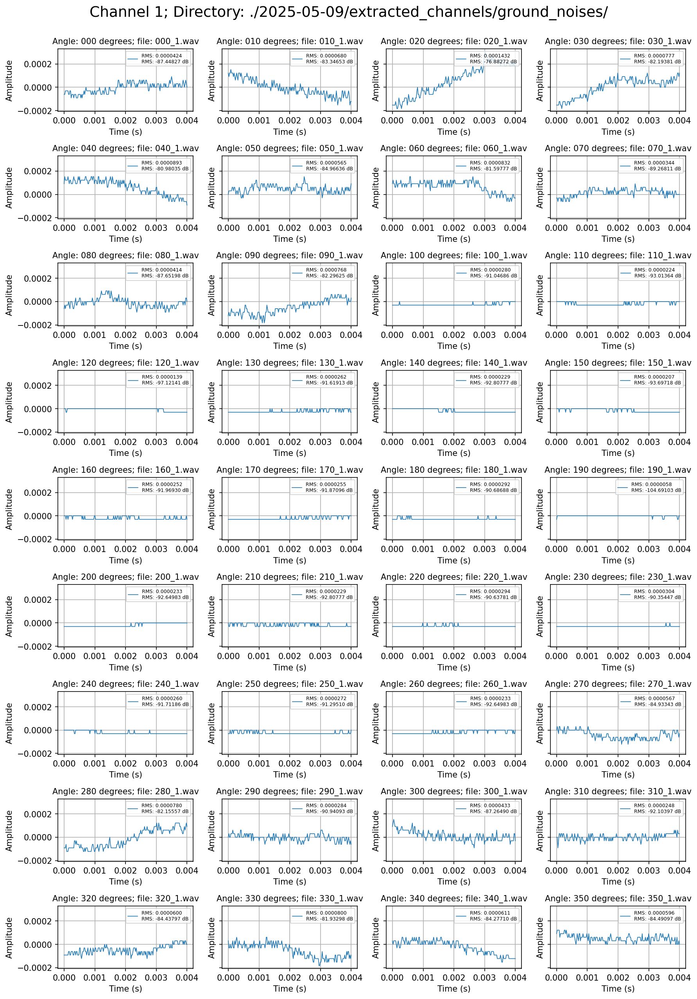

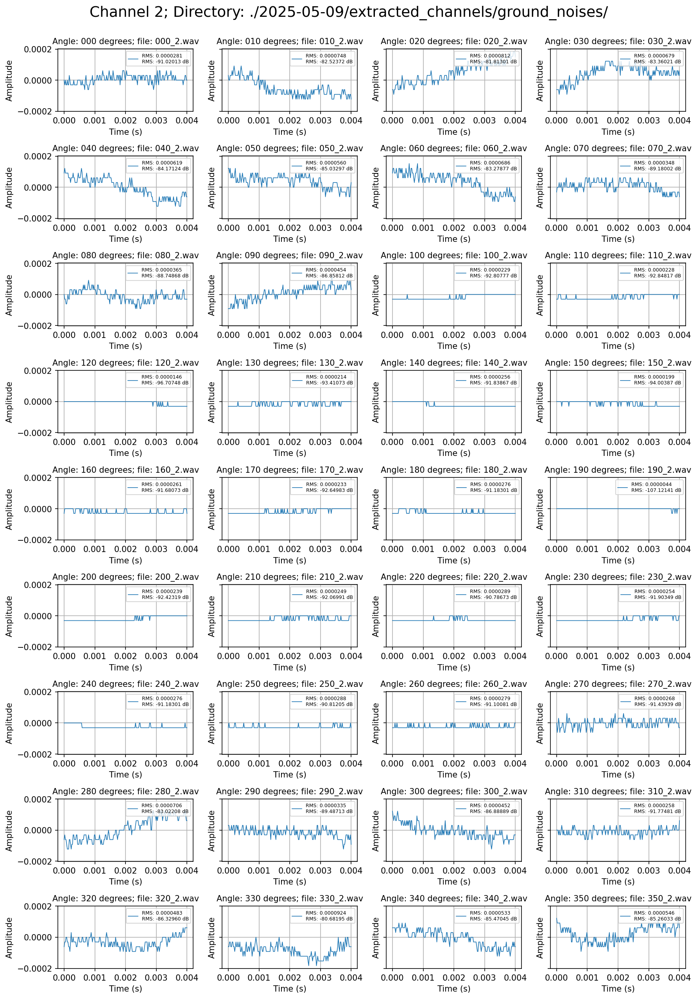

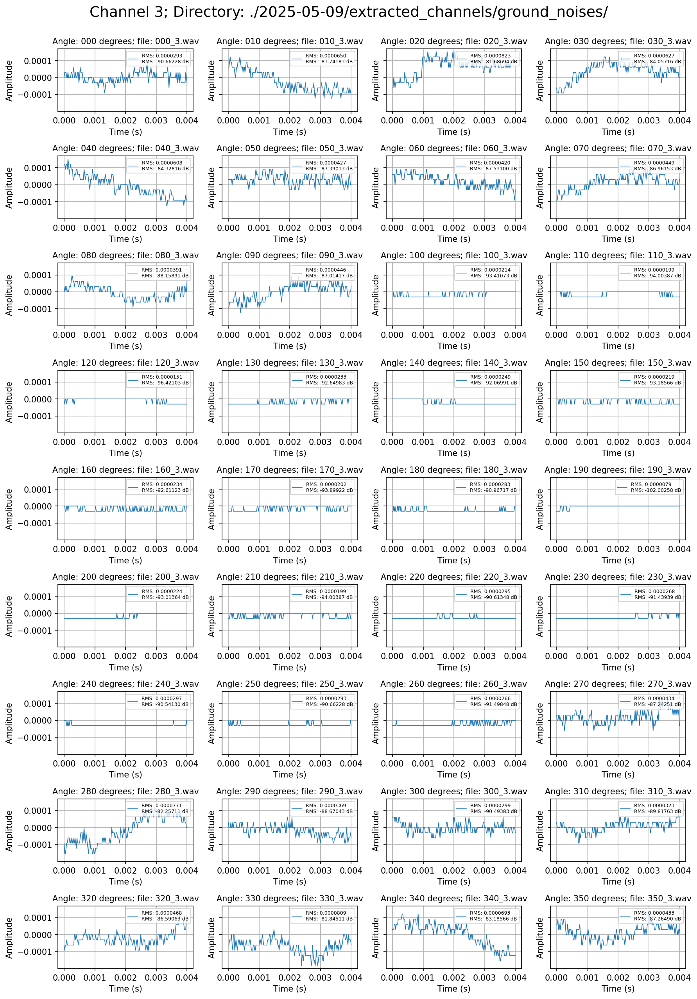

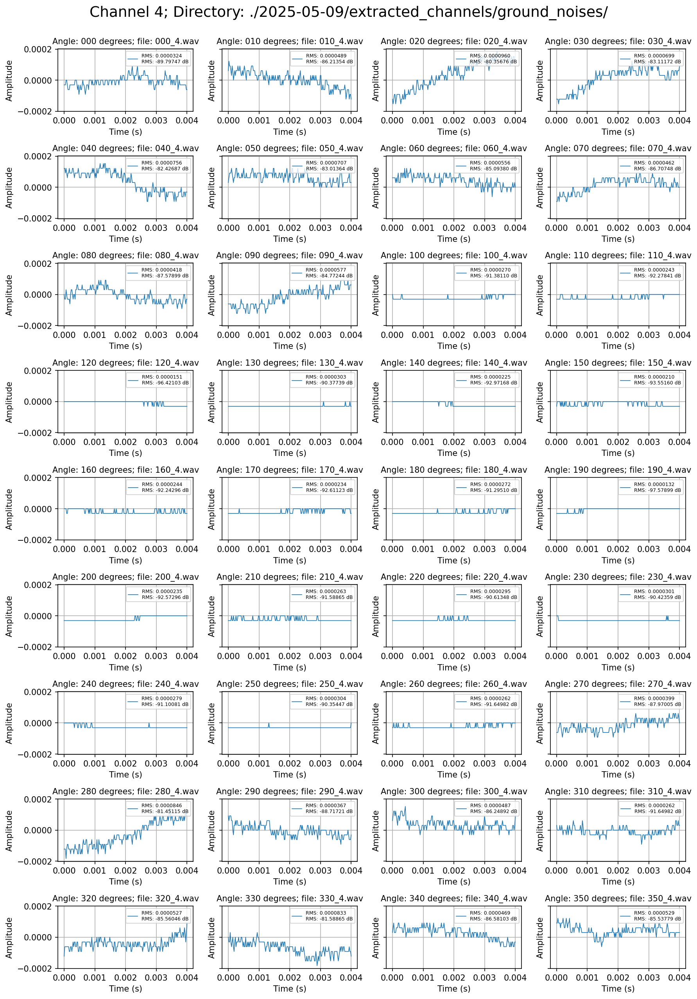

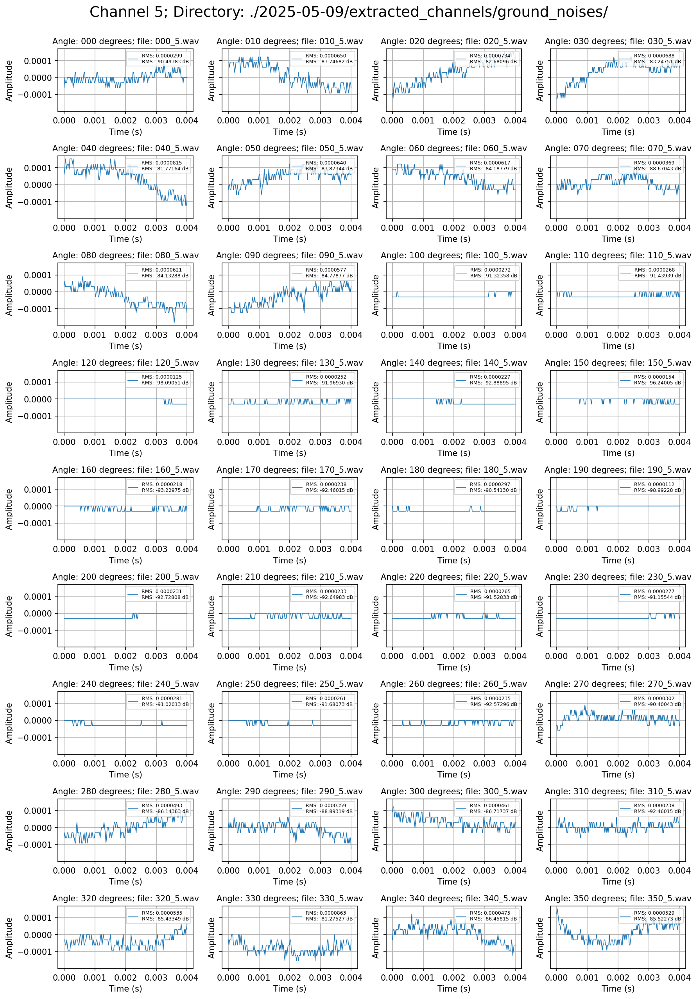

In [10]:
angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

channel_number = 0
for i in range(len(grouped_files)):
    channel_number += 1
    files = grouped_files[i+1]
    # Plot all angles, skipping '360'
    fig1, axs = plt.subplots(9, 4, figsize=(12, 17), sharey=True, dpi = 150)
    angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

    idx_to_plot = 0
    for idx, file in enumerate(files):
        if angles[idx] == '360':
            continue  # Skip the 360 angle

        file_path = os.path.join(DIR_noise, file)
        noise, sample_rate = sf.read(file_path)

        rms = np.sqrt(np.mean(noise**2))
        rms_db = 20 * np.log10(rms)
        
        row = idx_to_plot // 4
        col = idx_to_plot % 4
        
        ax = axs[row, col]
        ax.plot(np.linspace(0, len(noise) / sample_rate, len(noise)), noise, linewidth=0.8)
        ax.set_title(f"Angle: {angles[idx]} degrees; file: {file}", fontsize =10)  # Use extracted angle name with units
        ax.set_xlabel("Time (s)")
        ax.set_ylabel(f"Amplitude")
        ax.grid(True)
        ax.legend([f'RMS: {rms:.7f}\nRMS: {rms_db:.5f} dB'], loc='upper right', fontsize=6)

        idx_to_plot += 1
    # Add suptitle after plotting all subplots
    plt.suptitle(f"Channel {channel_number}; Directory: {DIR_noise}", fontsize=18, y=1)
    plt.tight_layout()  # Adjust layout to make room for suptitle
    plt.show(block = False)

plt.show(block = False)


9. Signal to Noise Ratio is calculated and displayed for all the  files, considering the +20 dB applied from 100 to 260 degrees


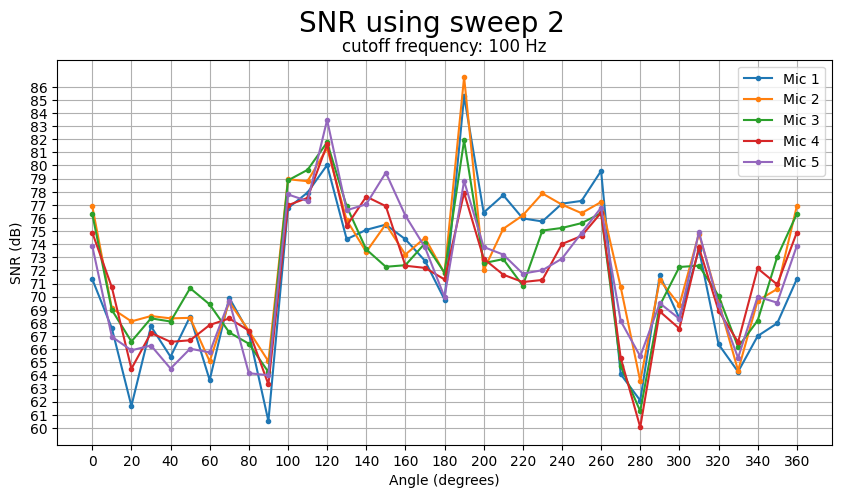

In [11]:
#%% overall SNR computation

def calculate_snr(audio, noise):

    # Compute signal power (RMS value squared)
    P_signal = np.mean(audio**2)

    # If noise segment is provided, extract noise power
    P_noise = np.mean(noise**2)

    # Compute SNR in dB
    SNR = 10 * np.log10(P_signal / P_noise)

    return SNR

DIR = f"./2025-05-09/extracted_channels/sweep_{sweep_SNR}/"  # Directory containing the audio files
fig_linear, ax_linear = plt.subplots(figsize=(10, 5))
fig_linear.suptitle("Overall RMS Values for All Channels", fontsize=16)

SNR_values_dict = {}
num_mics = num_channels
# Plot for each microphone
for mic in range(1, num_mics + 1):
    files = grouped_files[mic]
    angles = [int(file.split('_')[0]) for file in files]  # Extract angles from filenames

    # Create a figure with 3 polar subplots

    plt.suptitle(f"SNR using sweep {sweep_SNR}", fontsize=20)
    plt.title(f'cutoff frequency: {cutoff} Hz')

    for file in files:
        file_path = os.path.join(DIR, file)
        audio, fs = sf.read(file_path)

        angle_name = int(file.split('_')[0])
        if 100 <= angle_name <= 260:  
            audio *= db_to_linear(gain)

        noise_file_path = os.path.join(DIR_noise, file)
        noise, fs = sf.read(noise_file_path)
        
        # Calculate SNR
        SNR = calculate_snr(audio, noise)
        if do_print:
            print(f"SNR for {file}: {SNR:.2f} dB")
        SNR_values_dict[file] = SNR

    # Extract SNR values for the current mic in the order of angles/files
    snr_values = [SNR_values_dict[file] for file in files]

    # Plot SNR values in linear plot
    ax_linear.plot(angles, snr_values, marker='.', linestyle='-', label=f"Mic {mic}")
    ax_linear.set_xlabel("Angle (degrees)")
    ax_linear.set_xticks(np.linspace(0, 380, 19, endpoint=False))  # Set angle ticks
    ax_linear.set_ylabel("SNR (dB)")
    ax_linear.set_yticks(
        np.arange(
            int(np.min(list(SNR_values_dict.values()))),
            int(np.max(list(SNR_values_dict.values()))) + 1,
            1
        )
    )  # Set y-ticks
    ax_linear.legend()
    ax_linear.grid(True)

# Final notes

- **point 4**: the 5 sweeps in a single recording are individually extracted by correlating the correspondent template chirp. Each individual extracted chirp is saved and used later on for comparative analysis. Longer and shorter chirp do not change the overall results. RMS calculated values, however are still a mean of all the chirps. 

- **point 5**: the overall RMS level around the array has a drop at the back. The front-back drop (0-180) is around **27** dB RMS. The array was rotated around the central mic = 3. Some bumps in mic 1 2 4 5 appears from the polar plots. I interpret these bumps as an artifact created by the rotation of the array around its center: the mics at the sides move accordingly closer or further to the sound source during the measure, resulting in a higher overall dB RMS values. However, the theoretical spherical spreading suggests that (from "Acoustics: an introduction, Kuttruff, Heinrich, 2007, pag. 47):

    $
    r_1 \;=\; 1,5  m 
    $

    $
    r_2 \;=\; 1,464  m 
    $

    $
    \Delta L \;=\; L_2 - L_1 \;=\; -\,20 \log_{10}\!\Bigl(\frac{r_2}{r_1}\Bigr) \;=\; -\,20 \log_{10}\!\Bigl(\frac{1,464}{1,5}\Bigr) \;=\; 0,211 dB
    $

    Consider a point source at r1 = 1.5 m in the free field and a linear array 7,2 cm wide of 5 mics, distributed with a 1,8 cm costant spacing. If turned 90°, the external mics move of 3,6 cm, one towards the source and one away from it. Let's consider a distance r2 = 1,464 for the closest. The increase in dB is only of 0.2, much less than the recorded RMS value of up to 2 dB at the front. I then attribute this bumps in RMS values to the artifacts created by clipping of the mics, maybe induced by the high SPL (around 100 dB SPL) used in the recording session. More analysis on a different dataset at various distances and output level could help in understanding the unexpected array behaviour. 

- **point 9**: By Highpassing the recording with different cutoff frequncies the SNR seems to change and be dependent to it, looking smoother as the cutoff moves up in frequency.  
